In [1]:
import pandas as pd
import numpy as np
from datetime import datetime
import plotly.graph_objects as go
import plotly.figure_factory as ff
import plotly.express as px

In [2]:
df = pd.read_csv("us-states.csv", parse_dates=True) # src: nytimes

In [3]:
# load up state pops 
# add new cols.
pop_df = pd.read_csv("state-pops.csv", parse_dates=True)
pop_df = pop_df.append({'State' : 'Guam' , 'Pop' : 168838} , ignore_index=True)
pop_df = pop_df.append({'State' : 'Virgin Islands' , 'Pop' : 104419} , ignore_index=True)
pop_df = pop_df.append({'State' : 'Northern Mariana Islands', 'Pop' : 57573} , ignore_index=True)

def get_pop(state): 
    val = pop_df[pop_df['State'] == state]['Pop']
    return int(val)

In [4]:
df = df.drop(['fips'], axis=1)
df['deaths per 1m'] = df.apply(lambda x: x['deaths'] * 1000000 / get_pop(x['state']), axis=1) 
df['cases per 1m'] = df.apply(lambda x: x['cases'] * 1000000 / get_pop(x['state']), axis=1) 
df['mortality rate'] = df['deaths'] / df['cases']

In [5]:
from datetime import date
start = datetime.strptime(df['date'].values[0], '%Y-%m-%d')
end = datetime.strptime(df['date'].values[-1], '%Y-%m-%d')
delta = end - start
days = int(delta.days)

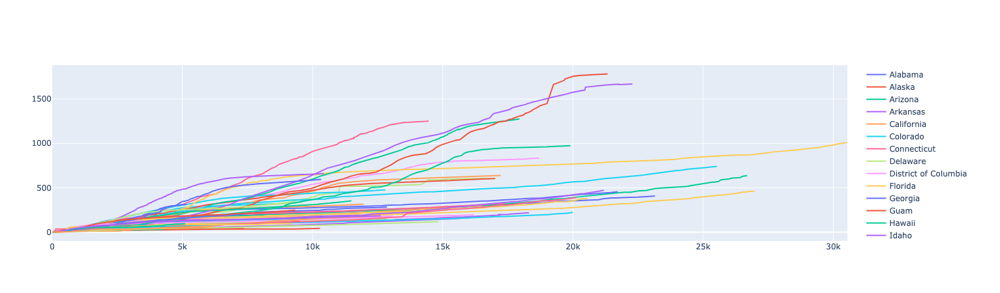

In [6]:
states = sorted(list(set(df['state'])))
fig = go.Figure()
for state in states:
    state_df = df[df['state'] == state]
    cases_per_1m = state_df['cases per 1m']
    deaths_per_1m = state_df['deaths per 1m']
    state_df['cases'] = state_df['cases'].apply(lambda x: '{:,}'.format(x))
    state_df['deaths'] = state_df['deaths'].apply(lambda x: '{:,}'.format(x))
    state_df['cases per 1m'] = state_df['cases per 1m'].apply(lambda x: '{:,.2f}'.format(x))
    state_df['deaths per 1m'] = state_df['deaths per 1m'].apply(lambda x: '{:,.2f}'.format(x))
    fig.add_trace(go.Scatter(
        x=cases_per_1m, 
        y=deaths_per_1m, 
#         cases=cases, 
#         deaths=deaths,
        customdata=state_df,
        mode='lines',
#         State: %{customdata[1]}<br>
        hovertemplate="""
        Date: %{customdata[0]}<br>
        Cases: %{customdata[2]}<br>
        Deaths: %{customdata[3]}<br>
        Cases per 1M: %{customdata[4]}<br>
        Deaths per 1M: %{customdata[5]}<br>
        """,
        name=state)
    )
# fig.update_layout(hovermode="x unified")

fig.show()

In [7]:
# states = sorted(list(set(df['state'])))
# fig = go.Figure()
# for state in states:
#     state_df = df[df['state'] == state]
#     from scipy.interpolate import UnivariateSpline
#     state_df = state_df.sort_values('cases per 1m')
#     spl = UnivariateSpline(list(state_df['cases per 1m']),list(state_df['deaths per 1m']))
#     dydx = spl.derivative(n=1)
#     cases_per_1m = state_df['cases per 1m']
#     dydx_deaths_per_1m = dydx(cases_per_1m)
#     deaths_per_1m = state_df['deaths per 1m']
#     state_df['cases'] = state_df['cases'].apply(lambda x: '{:,}'.format(x))
#     state_df['deaths'] = state_df['deaths'].apply(lambda x: '{:,}'.format(x))
#     state_df['cases per 1m'] = state_df['cases per 1m'].apply(lambda x: '{:,.2f}'.format(x))
#     state_df['deaths per 1m'] = state_df['deaths per 1m'].apply(lambda x: '{:,.2f}'.format(x))
#     fig.add_trace(go.Scatter(
#         x=cases_per_1m, 
#         y=dydx_deaths_per_1m, 
# #         cases=cases, 
# #         deaths=deaths,
#         customdata=state_df,
#         mode='lines',
# #         State: %{customdata[1]}<br>
#         hovertemplate="""
#         Date: %{customdata[0]}<br>
#         Cases: %{customdata[2]}<br>
#         Deaths: %{customdata[3]}<br>
#         Cases per 1M: %{customdata[4]}<br>
#         Deaths per 1M: %{customdata[5]}<br>
#         """,
#         name=state)
#     )
# # fig.update_layout(hovermode="x unified")

# fig.show()

In [8]:
df2 = pd.read_csv("owid-covid-data.csv")
df2['cases']= df2['total_cases']
df2['deaths']= df2['total_deaths']
df2['state'] = df2['location']

# add europe
eu = df2[df2['continent'] == "Europe"]
eu = eu.groupby('date').agg('sum')
eu['state'] = 'Europe'
eu['date'] = eu.index
df2 = df2.append(eu)

df2['deaths per 1m'] = df2.apply(lambda x: x['deaths'] * 1000000 / x['population'], axis=1) 
df2['cases per 1m'] = df2.apply(lambda x: x['cases'] * 1000000 / x['population'], axis=1) 
df2['mortality rate'] = df2['deaths'] / df2['cases']

In [9]:
from datetime import date
start = datetime.strptime(df2['date'].values[0], '%Y-%m-%d')
end = datetime.strptime(df['date'].values[-1], '%Y-%m-%d')
delta = end - start
days = int(delta.days)

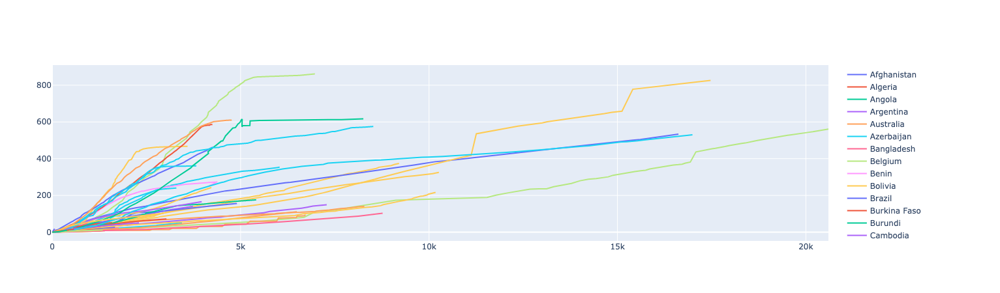

In [11]:
states = sorted(list(set(df2['state'])))
fig = go.Figure()
for state in states:
    state_df = df2[df2['state'] == state]
    if list(state_df['population'])[0] < 10000000:
        continue
    cases_per_1m = state_df['cases per 1m']
    deaths_per_1m = state_df['deaths per 1m']
    state_df['cases'] = state_df['cases'].apply(lambda x: '{:,}'.format(x))
    state_df['deaths'] = state_df['deaths'].apply(lambda x: '{:,}'.format(x))
    state_df['cases per 1m'] = state_df['cases per 1m'].apply(lambda x: '{:,.2f}'.format(x))
    state_df['deaths per 1m'] = state_df['deaths per 1m'].apply(lambda x: '{:,.2f}'.format(x))
    fig.add_trace(go.Scatter(
        x=cases_per_1m, 
        y=deaths_per_1m, 
#         cases=cases, 
#         deaths=deaths,
        customdata=state_df,
        mode='lines',
#         State: %{customdata[1]}<br>
        hovertemplate="""
        Date: %{customdata[3]}<br>
        Cases: %{customdata[40]}<br>
        Deaths: %{customdata[41]}<br>
        Cases per 1M: %{customdata[44]}<br>
        Deaths per 1M: %{customdata[43]}<br>
        """,
        name=state)
    )
# fig.update_layout(hovermode="x unified")

fig.show()